# Importation de données & Overview

Dans ce projet je vais focaliser que sur la variable 'Class' qui va prédire si l'entreprise va faire failite ou non .

In [2]:
from Scripts.Data_Exploration import * 
from Scripts.modelisation import * 
from Scripts.librairies import * 
from Scripts.transformation import *

In [2]:

data = pd.read_csv('./dataset/dataset.csv')
data = data.drop([data.columns[0], data.columns[1], data.columns[2], 'year','bankruptcy_after_years'], axis=1)
data.drop_duplicates(keep=False, inplace=True)

data.columns = data.columns.str.replace('Attr', 'X ')

data.head()

,X 1,X 2,X 3,X 4,X 5,X 6,X 7,X 8,X 9,X 10,...,X 56,X 57,X 58,X 59,X 60,X 61,X 62,X 63,X 64,class
0,0.200550,0.37951,0.39641,2.0472,32.3510,0.38825,0.249760,1.33050,1.1389,0.50494,...,0.121960,0.39718,0.87804,0.001924,8.4160,5.1372,82.658,4.4158,7.4277,0
1,0.209120,0.49988,0.47225,1.9447,14.7860,0.00000,0.258340,0.99601,1.6996,0.49788,...,0.121300,0.42002,0.85300,0.000000,4.1486,3.2732,107.350,3.4000,60.9870,0
2,0.248660,0.69592,0.26713,1.5548,-1.1523,0.00000,0.309060,0.43695,1.3090,0.30408,...,0.241140,0.81774,0.76599,0.694840,4.9909,3.9510,134.270,2.7185,5.2078,0
3,0.081483,0.30734,0.45879,2.4928,51.9520,0.14988,0.092704,1.86610,1.0571,0.57353,...,0.054015,0.14207,0.94598,0.000000,4.5746,3.6147,86.435,4.2228,5.5497,0
4,0.187320,0.61323,0.22960,1.4063,-7.3128,0.18732,0.187320,0.63070,1.1559,0.38677,...,0.134850,0.48431,0.86515,0.124440,6.3985,4.3158,127.210,2.8692,7.8980,0


In [3]:
data['class'] =data['class'].astype('category')

In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 42623 entries, 0 to 43404
Data columns (total 65 columns):
 #   Column  Non-Null Count  Dtype   
---  ------  --------------  -----   
 0   X 1     42615 non-null  float64 
 1   X 2     42615 non-null  float64 
 2   X 3     42615 non-null  float64 
 3   X 4     42491 non-null  float64 
 4   X 5     42534 non-null  float64 
 5   X 6     42615 non-null  float64 
 6   X 7     42615 non-null  float64 
 7   X 8     42531 non-null  float64 
 8   X 9     42614 non-null  float64 
 9   X 10    42615 non-null  float64 
 10  X 11    42579 non-null  float64 
 11  X 12    42491 non-null  float64 
 12  X 13    42500 non-null  float64 
 13  X 14    42615 non-null  float64 
 14  X 15    42587 non-null  float64 
 15  X 16    42530 non-null  float64 
 16  X 17    42531 non-null  float64 
 17  X 18    42615 non-null  float64 
 18  X 19    42499 non-null  float64 
 19  X 20    42500 non-null  float64 
 20  X 21    36805 non-null  float64 
 21  X 22    42615 non

In [6]:
print(f"Dataset avec { data.shape[0] } lignes et {data.shape[1]} colonnes. \n ")

Dataset avec 42623 lignes et 65 colonnes. 
 



+ **class :**  Une variable discrète avec 2 valeurs possibles de 0..1 où 0 indique que l'entreprise n'a pas été mise en faillite, 1 dans le cas contraire

In [7]:
data['class'].value_counts()


class
0    40548
1     2075
Name: count, dtype: int64

In [8]:
data.describe()

,X 1,X 2,X 3,X 4,X 5,X 6,X 7,X 8,X 9,X 10,...,X 55,X 56,X 57,X 58,X 59,X 60,X 61,X 62,X 63,X 64
count,42615.000000,42615.000000,42615.000000,42491.000000,4.253400e+04,42615.000000,42615.000000,42531.000000,42614.000000,42615.000000,...,4.262200e+04,4.250000e+04,42616.000000,4.254300e+04,42616.000000,4.049900e+04,42523.000000,4.250000e+04,42491.000000,41827.000000
mean,0.046494,0.593506,0.112895,6.372182,-3.869006e+02,-0.059066,0.102469,11.403598,2.495460,0.582431,...,7.529448e+03,-2.670092e+01,-0.009496,3.055854e+01,1.342246,4.561131e+02,17.191485,1.516011e+03,9.391249,72.481760
std,2.455629,5.895937,5.488965,298.132485,6.179780e+04,7.266992,5.616839,468.350117,57.697052,13.219180,...,7.024164e+04,5.376407e+03,13.794195,5.383009e+03,123.216280,3.264527e+04,558.091121,1.405283e+05,125.304756,2386.099949
min,-463.890000,-430.870000,-479.960000,-0.403110,-1.190300e+07,-508.410000,-517.480000,-141.410000,-3.496000,-479.910000,...,-1.805200e+06,-1.108300e+06,-1667.300000,-1.986900e+02,-327.970000,-1.244000e+01,-12.656000,-2.336500e+06,-1.543200,-10677.000000
25%,0.003337,0.270970,0.021583,1.049350,-4.916975e+01,0.000000,0.005693,0.426940,1.019200,0.293790,...,2.935375e+01,9.180225e-03,0.014805,8.759200e-01,0.000000,5.548750e+00,4.522850,4.201325e+01,3.100700,2.191950
50%,0.049658,0.473050,0.197140,1.569600,-8.242350e-01,0.000000,0.059567,1.064100,1.202100,0.504610,...,1.071200e+03,5.277250e-02,0.120380,9.511800e-01,0.005985,9.806900e+00,6.657100,7.120150e+01,5.094700,4.327500
75%,0.129835,0.690115,0.403895,2.783000,5.081150e+01,0.086116,0.151255,2.589250,2.076775,0.707250,...,4.878575e+03,1.284750e-01,0.286110,9.927200e-01,0.236997,2.032750e+01,10.449000,1.169725e+02,8.622400,9.888250
max,94.280000,480.960000,28.336000,53433.000000,1.250100e+06,543.250000,649.230000,53432.000000,9742.300000,1099.500000,...,6.123700e+06,2.931500e+02,552.640000,1.108300e+06,23853.000000,4.818700e+06,108000.000000,2.501600e+07,23454.000000,294770.000000


**Check des lignes dupliquées** 

In [9]:
print("{} duplicates existent .".format(data.duplicated().sum()))

0 duplicates existent .


**Check des  Valeurs Manquantes**

In [10]:
print("Missing Values:\n")
percent_missing = data.isnull().sum() / data.shape[0] * 100.00
missing_value_df = pd.DataFrame({'Colonne': data.columns,
                                 'Missing Values %': percent_missing})
missing_value_df.sort_values('Missing Values %', inplace=True, ascending=False)
missing_value_df

Missing Values:



,Colonne,Missing Values %
X 37,X 37,43.863642
X 21,X 21,13.649907
X 27,X 27,6.423762
X 60,X 60,4.983225
X 45,X 45,4.971494
...,...,...
X 10,X 10,0.018769
X 57,X 57,0.016423
X 59,X 59,0.016423
X 55,X 55,0.002346


Les variables avec **Missing Values** > 10 % : 
+ **X 37** ( (current assets - inventories) / long-term liabilities ) 
+ **X 21**  sales (n) / sales (n-1)

Dans la partie Data Trasformation on va les imputer avec la façon la plus appropriée.

# Exploration de données 

In [4]:
analysis=data_analysis(data)

## Distribution

In [12]:
analysis.pie_chart('class')

D'après le graphe ci-dessus, on remarque que presque **5 %** des entreprises sont en faillite .  


## Box Plot

**Le but  des BoxPlot et de détecter les valeurs abérrantes et de les traiter dans la partie transformation de données après.**

In [13]:
columns=data.columns.tolist()
columns.remove('class')

In [14]:
for col in columns[0:5]:
    analysis.box_plot(col)

## Violon Plot 

In [15]:
for col in columns[0:5]:
    analysis.plot_violinplots(data,col)

## Scatter Plot 

In [16]:
print("Scatter plot appliqué sur la variable X1 mais on peut passer n'importe quelle variable comme input \n")
for col in columns[1:5]:
    analysis.plot_scatterplots(data,col,'X 1','class')

Scatter plot appliqué sur la variable X1 mais on peut passer n'importe quelle variable comme input 



## Corrélation 

In [17]:
analysis.plot_correlation(data,'kendall')


Vu qu'on dispose de 64 variables, la visualisation de la matrice de corrélation parait non efficace, pour cela on va étudier la corrélation de chaque variable avec l'autre 

In [22]:
import itertools

# Renvoie une dataframe avec des paires d'attributs et la valeur corrélation  de Kendall correspondante


def correlation_pairs(matrix):        
    return pd.DataFrame([[(i,j),matrix.loc[i,j]] for i,j in list(itertools.combinations(matrix, 2))], columns=['paires','corrélation'])

In [21]:
corr_matrix = data.corr(method="kendall")
corr_matrix = correlation_pairs(corr_matrix)
print(corr_matrix.sort_values(by='corrélation',ascending=False))

            paires  corrélation
757   (X 14, X 18)     0.999873
375    (X 7, X 14)     0.999839
379    (X 7, X 18)     0.999712
1538  (X 32, X 52)     0.994654
435    (X 8, X 17)     0.970562
...            ...          ...
1570  (X 33, X 52)    -0.997497
1865  (X 44, X 61)    -0.999105
2074  (X 62, X 63)    -0.999240
78     (X 2, X 17)    -0.999579
1084  (X 20, X 60)    -0.999778

[2080 rows x 2 columns]


In [22]:
print("Les paires des attributs positivement corrolés **( > 0.8 )** sont : \n")
print(corr_matrix[corr_matrix['corrélation'].between(0.8, 1)].sort_values(by='corrélation',ascending=False)['paires'])


Les paires des attributs positivement corrolés **( > 0.8 )** sont : 

757     (X 14, X 18)
375      (X 7, X 14)
379      (X 7, X 18)
1538    (X 32, X 52)
435      (X 8, X 17)
428      (X 8, X 10)
864     (X 16, X 26)
5         (X 1, X 7)
12       (X 1, X 14)
16       (X 1, X 18)
1002    (X 19, X 23)
546     (X 10, X 17)
1402    (X 28, X 54)
1010    (X 19, X 31)
1071    (X 20, X 47)
372      (X 7, X 11)
597     (X 11, X 14)
601     (X 11, X 18)
1184    (X 23, X 31)
1548    (X 32, X 62)
1998    (X 52, X 62)
9        (X 1, X 11)
1581    (X 33, X 63)
1927    (X 48, X 49)
1146    (X 22, X 35)
2002    (X 53, X 54)
1731    (X 39, X 42)
151      (X 3, X 28)
1159    (X 22, X 48)
1401    (X 28, X 53)
Name: paires, dtype: object


In [25]:
print("Les paires des attributs négativement corrolés **( < -0.8 )** sont : \n")
print(corr_matrix[corr_matrix['corrélation'].between(-1, -0.8)].sort_values(by='corrélation',ascending=False)['paires'])


Les paires des attributs négativement corrolés **( < -0.8 )** sont : 

2036    (X 56, X 58)
1580    (X 33, X 62)
1714    (X 38, X 51)
1999    (X 52, X 63)
1549    (X 32, X 63)
1921    (X 47, X 60)
71       (X 2, X 10)
69        (X 2, X 8)
1519    (X 32, X 33)
1570    (X 33, X 52)
1865    (X 44, X 61)
2074    (X 62, X 63)
78       (X 2, X 17)
1084    (X 20, X 60)
Name: paires, dtype: object


**La règle dit que pour deux variables hautement corrolées ( positivement ou négativement ) on doit éliminer l'une des deux pour eviter la redondance de l'information et par la suite on tombe dans un problème de overfitting**. 
+ Dans la partie Sélection de variable on va opter pour l'élimination des variables selon le critère de corrélation et des règle métier.

# Data Transformation & Feature Selection 

## Traiter les valeurs abérrantes 

In [5]:
data_transformation=transformation(data,'class')

In [6]:
data=data_transformation.remove_outliers(data)

## Imputation des valeurs manquantes 

**Rappel :**
Les variables avec **Missing Values** > 10 % : 
+ **X 37** ( (current assets - inventories) / long-term liabilities ) avec ~ 44% des valeurs manquantes donc on va l'éliminer pour ne pas changer la distribution de la variable ou d'ajouter de fausses informations si on va l'imputer 
+ **X 21**  sales (n) / sales (n-1) ~ 13%

On va opter pour imputer les valeurs manquantes par le mean pour le reste des variables

In [8]:
data=data.drop('X 37',axis=1)

In [7]:
data=data_transformation.impute_missing_values(data,'mean')

## Sélection des variables 

### Corrélation 

**Rappel** 
Les paires des attributs positivement corrolés **( > 0.8 )** sont : 
+ X14 & X18 
+ X7 & X14 
+ X7 & X18 
+ X32 & X52 
+ X8 & X17 
+ X8 & X10 
+ X16 & X26 
+ X1 & X14 
+ X1 & X18   
+ X19 & X23 
+ X10 & X17 
+ X28 & X54 
+ X19 & X31  
+ X47 & X20 
+ X7 & X11  
+ X11 & X14  
+ X11 & X18  
+ X23 & X31  
+ X32 & X62  
+ X52 & X62
+ X1 & X11
+ X33 & X63
+ X48 & X49
+ X22 & X35
+ X53 & X54
+ X39 & X42
+ X3 & X28
+ X22 & X48
+ X28 & X53



Les paires des attributs négativement corrolés **( < -0.8 )** sont : 
+ X56 & X58 
+ X33 & X62 
+ X38 & X51 
+ X52 & X63 
+ X32 & X63 
+ X47 & X60 
+ X2 & X10 
+ X2 & X8 
+ X32 & X33 
+ X33 & X52 
+ X 44 & X 61
+ X 6 & X 63
+ X 2 &  X 17
+ X 20 & X 60


On remarque que **X14 & X18 & X7 & X1 & X11** sont tous corrolées entre eux : 

En comparant les différent ratios financiers:
+ (gross profit + interest) / total assets
+ net profit / total assets
+ EBIT / total assets
+ gross profit / total assets
+ (gross profit + extraordinary items + financial expenses) / total assets

X14 et X18 pratiquement nous donne la même information **=>** On opte pour choisir dans ce cas net profit / total assets qui est X 1 

**Entre X1 & X7 & X11** : 

+ Net Profit / Total Assets:
Ce ratio financier mesure la rentabilité d'une entreprise en comparant son bénéfice net (revenu net après déduction des dépenses) à ses actifs totaux. Il indique la capacité de l'entreprise à générer des bénéfices par rapport à ses ressources totales. Un ratio élevé peut indiquer une bonne rentabilité et une utilisation efficace des actifs.

+ EBIT / Total Assets:
Ce ratio financier mesure la rentabilité opérationnelle d'une entreprise en comparant son bénéfice avant intérêts et impôts (EBIT) à ses actifs totaux. Il exclut les charges d'intérêts et les impôts pour se concentrer uniquement sur la rentabilité générée par les activités principales de l'entreprise. Un ratio élevé indique une bonne rentabilité des opérations.

+ (gross profit + extraordinary items + financial expenses) / total assets : 
Le ratio "(gross profit + extraordinary items + financial expenses) / total assets" est un indicateur financier qui permet d'évaluer la rentabilité et l'utilisation des actifs totaux d'une entreprise. Il est calculé en additionnant le bénéfice brut, les éléments extraordinaires et les charges financières, puis en divisant le résultat par les actifs totaux.

**==> On opte pour le premier ratio X1 Net Profit/Total Assests , tous ces ratios mesure la rentabilité de l'entreprise**

In [9]:
new_deleted_variable=['X 7','X 14','X 18','X 11']

On remarque que **X8 & X10 & X17 & X2** sont tous corrolées entre eux : 

En comparant les différent ratios financiers:
+  total liabilities / total assets
+ book value of equity / total liabilities
+ equity / total assets
+ total assets / total liabilities

X2 et X17 pratiquement nous donne la même information **=>** On opte pour choisir dans ce cas equity / total assets  qui est X 10

**Entre X10 & X8** : 

+ Equity / Total Assets :
Ce ratio financier mesure la proportion des actifs totaux d'une entreprise financée par les capitaux propres. Il est calculé en divisant les capitaux propres de l'entreprise par ses actifs totaux. Un ratio élevé indique que l'entreprise a une part plus importante de financement par capitaux propres plutôt que par dettes. Cela peut être interprété comme une indication de la stabilité financière et de la solidité de l'entreprise.

+ Book Value of Equity / Total Liabilities :
Ce ratio financier compare la valeur comptable des capitaux propres de l'entreprise à ses passifs totaux. Il est calculé en divisant la valeur comptable des capitaux propres par les passifs totaux de l'entreprise. Un ratio élevé peut indiquer que les capitaux propres de l'entreprise sont supérieurs à ses dettes totales. Cela peut être interprété comme une indication de la capacité de l'entreprise à rembourser ses dettes en utilisant ses actifs nets.
**==> On opte pour le premier ratio X10 Equity / Total Assets**

In [10]:
new_deleted_variable.extend(['X 8','X 17','X 2'])

**Entre X 16 & X 26**

 (gross profit + depreciation) / total liabilities **VS** (net profit + depreciation) / total liabilities

 Dans le premier cas on a opter pour net profit que fross profit , dans cas on va garder  (gross profit + depreciation) => X 16 

In [11]:
new_deleted_variable.append('X 26')

On remarque que **X32 & X33 & X 52 & X 62 & X 63** sont tous corrolées entre eux : 

En comparant les différents ratios financiers:
+  (current liabilities * 365) / cost of products sold
+ operating expenses / short-term liabilities
+ (short-term liabilities * 365) / cost of products sold)
+ (short-term liabilities *365) / sales
+  sales / short-term liabilities


+ (Current Liabilities * 365) / Cost of Products Sold :
Ce ratio est utilisé pour évaluer la capacité de l'entreprise à rembourser ses dettes à court terme à partir des revenus générés par la vente de produits. Il mesure le nombre de jours nécessaires pour rembourser les dettes à court terme à partir des ventes réalisées. Un ratio plus bas peut indiquer une meilleure capacité de l'entreprise à honorer ses dettes à court terme.

+ Operating Expenses / Short-term Liabilities :
Ce ratio mesure la proportion des dépenses opérationnelles de l'entreprise par rapport à ses dettes à court terme. Il permet d'évaluer l'impact des dépenses opérationnelles sur la structure financière de l'entreprise. Un ratio plus élevé peut indiquer une plus grande dépendance de l'entreprise vis-à-vis des dettes à court terme pour financer ses opérations.

+ (Short-term Liabilities * 365) / Cost of Products Sold :
Ce ratio évalue la capacité de l'entreprise à rembourser ses dettes à court terme à partir des revenus générés par la vente de produits. Il mesure le nombre de jours nécessaires pour rembourser les dettes à court terme à partir des ventes réalisées. Un ratio plus bas indique une meilleure capacité de l'entreprise à honorer ses dettes à court terme.

+ (Short-term Liabilities * 365) / Sales :
Ce ratio mesure la capacité de l'entreprise à rembourser ses dettes à court terme à partir des revenus totaux générés par les ventes. Il permet d'évaluer la proportion des ventes utilisées pour rembourser les dettes à court terme. Un ratio plus bas peut indiquer une meilleure capacité de l'entreprise à honorer ses dettes à court terme.

+ Sales / Short-term Liabilities :
Ce ratio mesure la capacité de l'entreprise à générer des ventes par rapport à ses dettes à court terme. Il permet d'évaluer la capacité de l'entreprise à générer des revenus suffisants pour rembourser ses dettes à court terme. Un ratio plus élevé peut indiquer une meilleure capacité de l'entreprise à rembourser ses dettes à court terme.


Pratiquement tous les ratios évaluent la capacité de l'entreprise à rembourser ses dettes à court terme .

**==> On opte pour le premier ratio X32 (Current Liabilities * 365) / Cost of Products Sold**

In [12]:
new_deleted_variable.extend(['X 33','X 52','X 62','X 63'])

**Entre X20 & X47 & X 60** 
* (inventory * 365) / cost of products sold **VS** sales / inventory **VS**  (inventory * 365) / sales

+ (inventory * 365) / sales : 
Le ratio "(inventory * 365) / sales" est un indicateur financier qui permet d'évaluer la rotation des stocks d'une entreprise. Il est calculé en multipliant les stocks par 365 (le nombre de jours dans une année) et en divisant le résultat par les ventes.

**==> On opte pour le ration X20**

In [13]:
new_deleted_variable.extend(['X 60','X 47'])

**Entre X56  X 58** 
+ (sales - cost of products sold) / sales  **VS** total costs /total sales

**==> On opte pour le ration X58**

In [14]:
new_deleted_variable.append('X 56')

**Entre X 19 & X 23 & X 31**
+ gross profit / sales **VS** net profit / sales  **VS**  (gross profit + interest) / sales

 ==> On opte pour X 23 

In [15]:

new_deleted_variable.extend(['X 19','X 31'])

**Entre X 3 & X 28 & X 54 & X 58**
+ working capital / total assets **VS** working capital / fixed assets  **VS**  constant capital / fixed assets **VS** total costs /total sales

+  working capital / fixed assets :
Le ratio "working capital / fixed assets" est un indicateur financier qui permet d'évaluer la solvabilité et la capacité d'une entreprise à financer ses actifs fixes avec son fonds de roulement. Il est calculé en divisant le fonds de roulement (working capital) par les actifs fixes (fixed assets).

 ==> On opte pour X 28

In [16]:
new_deleted_variable.extend(['X 3','X 54','X 58'])

**Entre X22 & X35 & X 48 & X 49**
+ profit on operating activities / total assets **VS** profit on sales / total assets  **VS**  EBITDA (profit on operating activities - depreciation) / total assets **VS**  EBITDA (profit on operating activities - depreciation) / sales

+  profit on operating activities / total assets :
Ce ratio mesure la capacité de l'entreprise à générer des profits à partir de ses activités opérationnelles par rapport à la taille de ses actifs. Il permet d'évaluer l'efficacité et la rentabilité de l'utilisation des actifs de l'entreprise.

 ==> On opte pour X 22

In [17]:
new_deleted_variable.extend(['X 35','X 48','X 49'])

In [18]:
# Les autres variables corrolées 2 a 2
new_deleted_variable.extend(['X 42','X 51','X 61','X 63'])

In [19]:
data=data.drop(new_deleted_variable,axis=1)

In [20]:
analysis.plot_correlation(data,'kendall')


In [23]:
corr_matrix = data.corr(method="kendall")
corr_matrix = correlation_pairs(corr_matrix)
print(corr_matrix[corr_matrix['corrélation'].between(0.8, 1)].sort_values(by='corrélation',ascending=False)[0:10])
print(corr_matrix[corr_matrix['corrélation'].between(-1, -0.8)].sort_values(by='corrélation',ascending=False)[0:10])



Empty DataFrame
Columns: [paires, corrélation]
Index: []
Empty DataFrame
Columns: [paires, corrélation]
Index: []


+ On remarque que pas d'autres variables corrolées 

## VIF ( variance inflation factor) Check

In [26]:
scaler = StandardScaler()
X=data.drop('class',axis=1)
X_scaled = scaler.fit_transform(X)

In [27]:
X_scaled_df = pd.DataFrame(X_scaled, columns=X.columns)
vif = pd.DataFrame()
vif["Variable"] = X_scaled_df.columns
vif["VIF"] = [variance_inflation_factor(X_scaled_df.values, i) for i in range(X_scaled_df.shape[1])]


In [28]:
vif = vif.sort_values(by="VIF", ascending=False)


In [30]:
vif

,Variable,VIF
5,X 10,6.635943
23,X 38,4.618184
0,X 1,3.891344
22,X 36,3.784755
1,X 4,3.593810
13,X 23,3.469374
31,X 50,3.412333
30,X 46,3.363485
27,X 43,3.333029
12,X 22,3.110416


Pratiquement le VIF de toutes les variables est proche de 1 , et aucune variable a un VIF > 10 **==>** Pas multi-colinéarité

### Anova

In [31]:
data['class']=data['class'].astype('category')


In [32]:
anova_result=data_transformation.anova_test(data)


In [48]:
anova_result

,Variable,F-value,p-value
0,X 1,75.678273,3.455582e-18
1,X 4,449.062218,3.754928e-99
2,X 5,0.767139,3.811086e-01
3,X 6,37.252230,1.046893e-09
4,X 9,3.789574,5.157934e-02
5,X 10,443.160901,7.008296e-98
6,X 12,132.493288,1.295301e-30
7,X 13,219.825979,1.312608e-49
8,X 15,125.992300,3.392373e-29
9,X 16,225.067213,9.569294e-51


In [33]:
deleted_variables=list(set( data.columns.tolist() ) - set( anova_result[anova_result['p-value'] < 0.05]['Variable'].tolist()))


In [34]:
print('Les variables supprimées sont : \n')
for item in deleted_variables :
    print(item , '\n')
    


Les variables supprimées sont : 

X 5 

X 9 

X 64 

class 

X 43 

X 59 



In [35]:
deleted_variables.remove('class')


In [36]:
data=data.drop(deleted_variables,axis=1)

In [37]:
print(f"Après l'analyse d'ANOVA , on a terminé par {data.shape[1]} colonnes :")

Après l'analyse d'ANOVA , on a terminé par 33 colonnes :


### Mutual_info

La fonction **mutual_info_classif** est utilisée pour calculer la mesure d'information mutuelle entre les variables indépendantes (caractéristiques) et la variable cible dans un problème de classification.

In [44]:


Y = data['class']
mutual_ifo = data_transformation.select_k_best(mutual_info_classif, X_scaled_df, Y)


   feature_names  mutual_info
10          X 27     0.015897
4           X 15     0.013194
17          X 46     0.012988
6           X 22     0.012398
8           X 24     0.012013
3           X 13     0.010421
15          X 41     0.010176
12          X 38     0.009138
5           X 16     0.008892
13          X 39     0.008823
9           X 25     0.008711
1            X 4     0.008692
2           X 10     0.008490
7           X 23     0.008410
14          X 40     0.006603
16          X 45     0.006569
19          X 57     0.006568
0            X 1     0.006287
18          X 50     0.005965
11          X 28     0.005902


In [49]:
set(data.columns)  & set(mutual_ifo)


{'X 1',
 'X 10',
 'X 13',
 'X 15',
 'X 16',
 'X 22',
 'X 23',
 'X 24',
 'X 25',
 'X 27',
 'X 28',
 'X 38',
 'X 39',
 'X 4',
 'X 40',
 'X 41',
 'X 45',
 'X 46',
 'X 50',
 'X 57'}

Les variables d'intersection : 

+ 'X 1' : net profit / total assets
+ 'X 10' : equity / total assets
+ 'X 13' : (gross profit + depreciation) / sales
+ 'X 15' : (total liabilities * 365) / (gross profit + depreciation)
+ 'X 16' : (gross profit + depreciation) / total liabilities
+ 'X 22' : profit on operating activities / total assets
+ 'X 23' : net profit / sales
+ 'X 24' : gross profit (in 3 years) / total assets
+ 'X 25' : (equity - share capital) / total assets
+ 'X 27' : profit on operating activities / financial expenses
+ 'X 28' : working capital / fixed assets
+ 'X 38' : constant capital / total assets
+ 'X 39' :  profit on sales / sales
+ 'X 4'  : current assets / short-term liabilities
+ 'X 40' : (current assets - inventory - receivables) / short-term liabilities
+ 'X 41' : total liabilities / ((profit on operating activities + depreciation) * (12/365))
+ 'X 45' : net profit / inventory
+ 'X 46' : (current assets - inventory) / short-term liabilities
+ 'X 50' : current assets / total liabilities
+ 'X 57' : (current assets - inventory - short-term liabilities) / (sales - gross profit - depreciation)


In [50]:
print(f"Finalement , on part vers la partie modélisation avec {len(list(set(data.columns)  & set(mutual_ifo)))} variables .")

Finalement , on part vers la partie modélisation avec 20 variables .


In [51]:
liste_finale=list(set(data.columns)  & set(mutual_ifo))


In [52]:
liste_finale.append('class')

In [53]:
data=data.loc[:,liste_finale]

# Modélistion & Evaluation & Hyperparameter Tuning

Notre data est purement umbalanced pour cela j'ai pensé à implementer le techique SMOTE , et on va comprarer les résultats , avant et après SMOTE

In [54]:
analysis.pie_chart('class')

In [55]:
data.to_csv('./Artifacts/data_finale.csv')

## Avant SMOTE

In [23]:
dataset=pd.read_csv('./Artifacts//data_finale.csv')

In [24]:
dataset=dataset.drop('Unnamed: 0',axis=1)

In [25]:
dataset['class']=dataset['class'].astype('category')

In [27]:
modelisation=modeling(dataset,'class')

In [6]:
X_train, X_test, y_train, y_test=modelisation.train_test_split(0.3)

In [7]:
X_train_scaled,X_test_scaled=modelisation.standardize(X_train=X_train,X_test=X_test)

In [8]:
model_comparison_df,best_model=modelisation.train_models(X_train_scaled,y_train,X_test_scaled,y_test,SMOTE=False)

Champion model: DecisionTreeClassifier , F1_score : 0.5831935347177601 Accuracy : 0.9143661531242668


In [9]:
model_comparison_df

,model_name,accuracy_score,precision_score,recall_score,f1_score
2,Decision Tree,0.914366,0.574671,0.595342,0.583194
4,XGBoost,0.955111,0.885986,0.532688,0.549645
3,K Nearest Neighbor,0.949715,0.632378,0.522788,0.531044
1,Random Forest,0.953625,0.863332,0.513844,0.515228
0,LogisticRegresion,0.952686,0.476343,0.5,0.487885


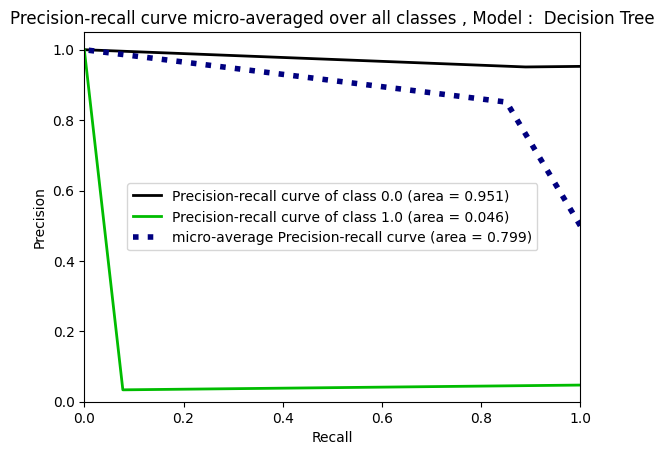

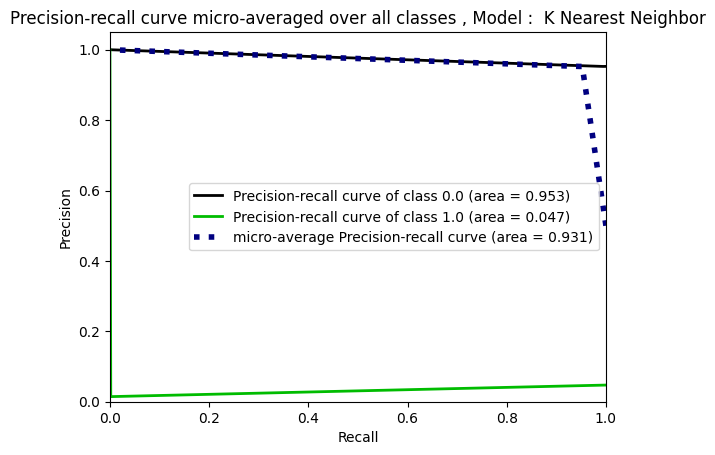

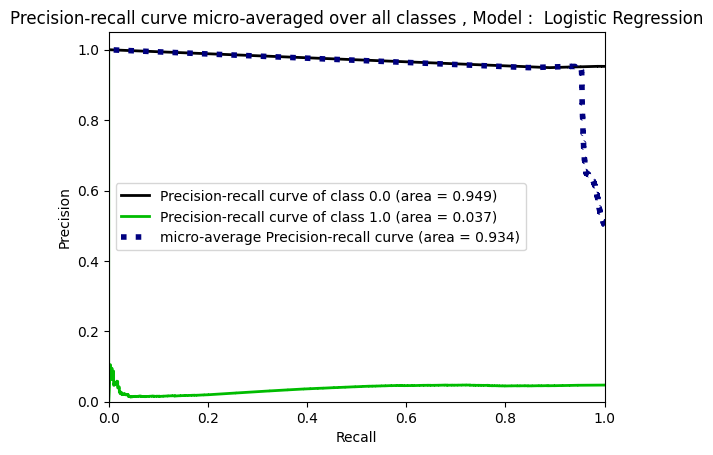

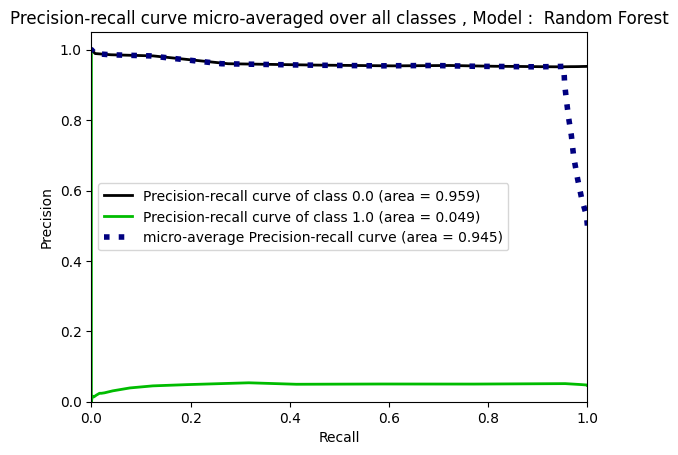

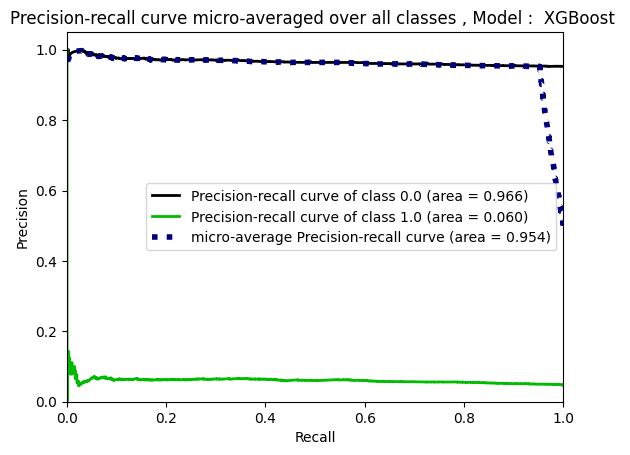

In [12]:
models_SMOTE ={'./Artifacts/Decision Tree.pkl': 'Decision Tree', 
            './Artifacts/K Nearest Neighbor.pkl':'K Nearest Neighbor',
            './Artifacts/LogisticRegresion.pkl': 'Logistic Regression',
            './Artifacts/Random Forest.pkl': 'Random Forest',
             './Artifacts/XGBoost.pkl': 'XGBoost '}
            

for in_dir, title in models_SMOTE.items():    
    modelisation.plot_curves(in_dir, X_test, y_test, title)

## Après SMOTE

In [26]:
sm = SMOTE(random_state=175)


In [28]:
modelisation.X,modelisation.y=sm.fit_resample(modelisation.X,modelisation.y)

In [29]:
X_train_smote, X_test_smote, y_train_smote, y_test_smote =modelisation.train_test_split(0.3)

In [30]:
X_train_scaled_smote,X_test_scaled_smote=modelisation.standardize(X_train_smote, X_test_smote)

In [31]:
model_comparison_df_smote,best_model_smote=modelisation.train_models(X_train_scaled_smote,y_train_smote,X_test_scaled_smote, y_test_smote,SMOTE=True)

Champion model: RandomForestClassifier , F1_score : 0.9302412635675242 Accuracy : 0.9303300587775906


In [32]:
model_comparison_df_smote

,model_name,accuracy_score,precision_score,recall_score,f1_score
1,Random Forest,0.93033,0.93252,0.930326,0.930241
3,K Nearest Neighbor,0.885281,0.902867,0.885268,0.884013
4,XGBoost,0.84241,0.867671,0.842394,0.839652
2,Decision Tree,0.79247,0.792542,0.792471,0.792457
0,LogisticRegresion,0.677381,0.68139,0.677372,0.675581


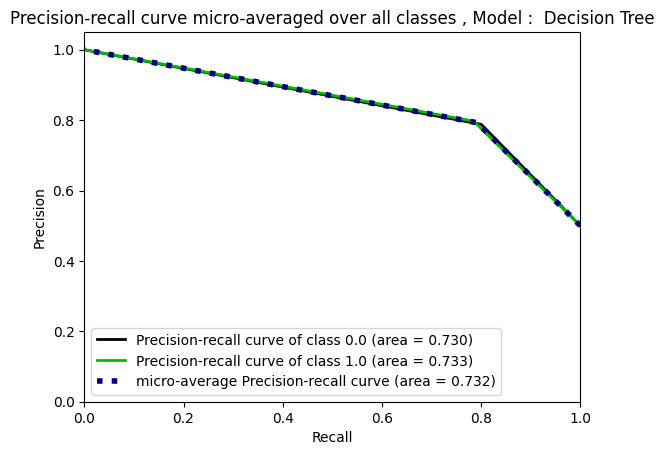

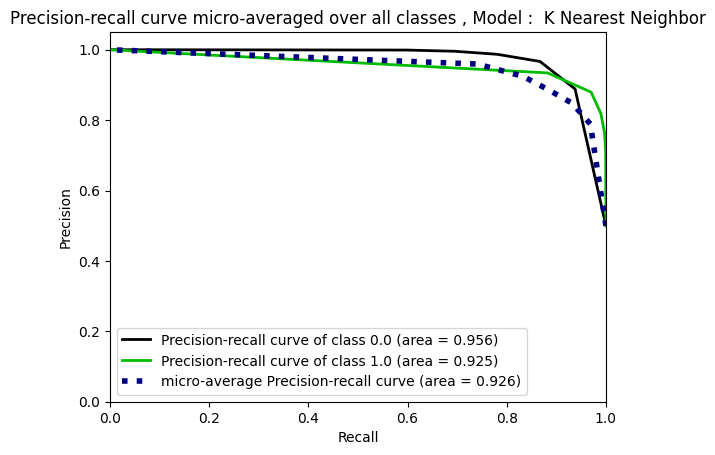

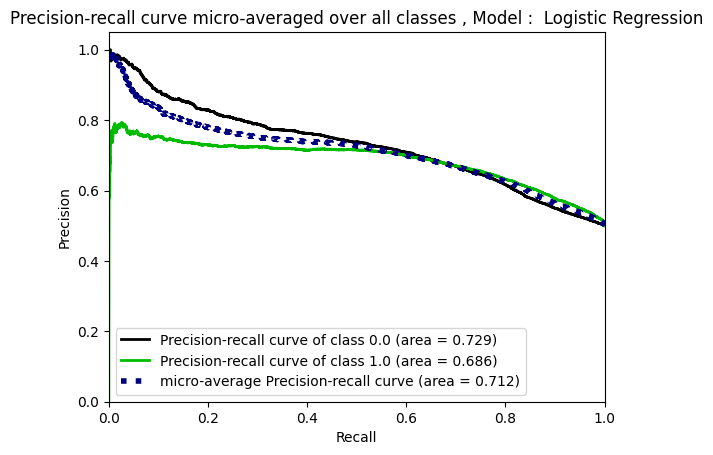

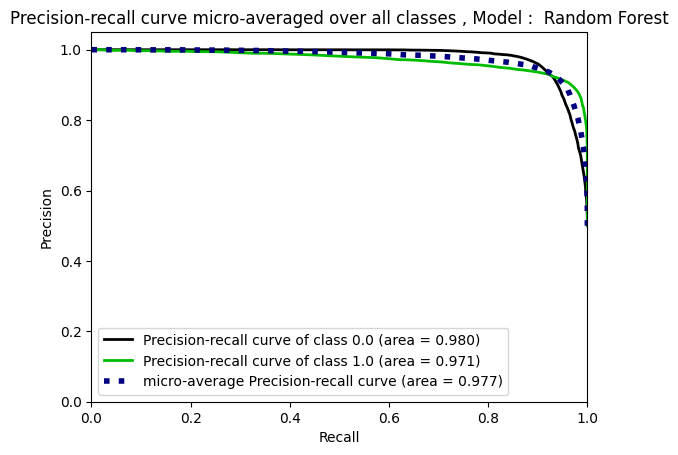

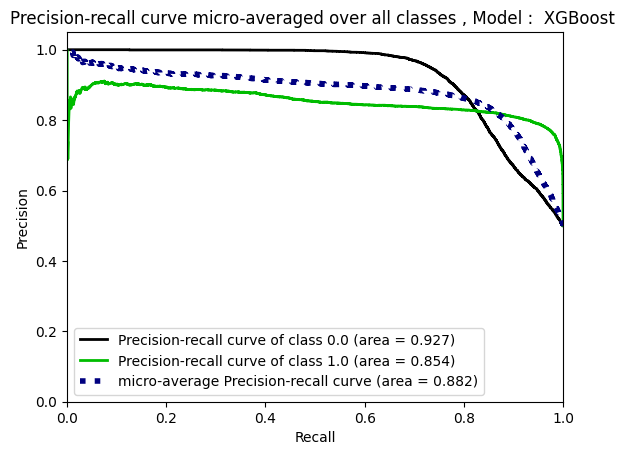

In [33]:
models_SMOTE ={'./Artifacts/Decision Tree_Smote.pkl': 'Decision Tree', 
            './Artifacts/K Nearest Neighbor_Smote.pkl':'K Nearest Neighbor',
            './Artifacts/LogisticRegresion_Smote.pkl': 'Logistic Regression',
            './Artifacts/Random Forest_Smote.pkl': 'Random Forest',
             './Artifacts/XGBoost_Smote.pkl': 'XGBoost '}
            

for in_dir, title in models_SMOTE.items():    
    modelisation.plot_curves(in_dir, X_test_scaled_smote, y_test_smote, title)

## Interprétation des modèles 

**Avant SMOTE** :
+ la performance de tous les modèles est pratiquement médiocre , les modèles ne peuvent pas faire la discrimination entre les différentes classes.
+ K Nearest Neighbor par exemple a tendance à classer les entreprises non en faillite sur les données avec un taux de 95%, mais ne parvient pas à classer les observations de l'autre classe ( ~ 4% ).

**Après SMOTE**:
+ Une amélioration remarquable au niveau des performances des modèles. 
+ Random forest classifier ( SMOTE ) conduit à une micro-moyenne AUC d'environ 0,977, mais il existe un risque élevé de overfitting.

In [34]:
best_model_smote=pickle.load(open('./Artifacts/random forest_Smote.pkl','rb'))

In [35]:
imp_df=pd.DataFrame({
    "Feature Name":modelisation.X.columns,
    "Importance":best_model_smote.feature_importances_
})

In [36]:
imp_df=imp_df.sort_values(by="Importance",ascending=False)

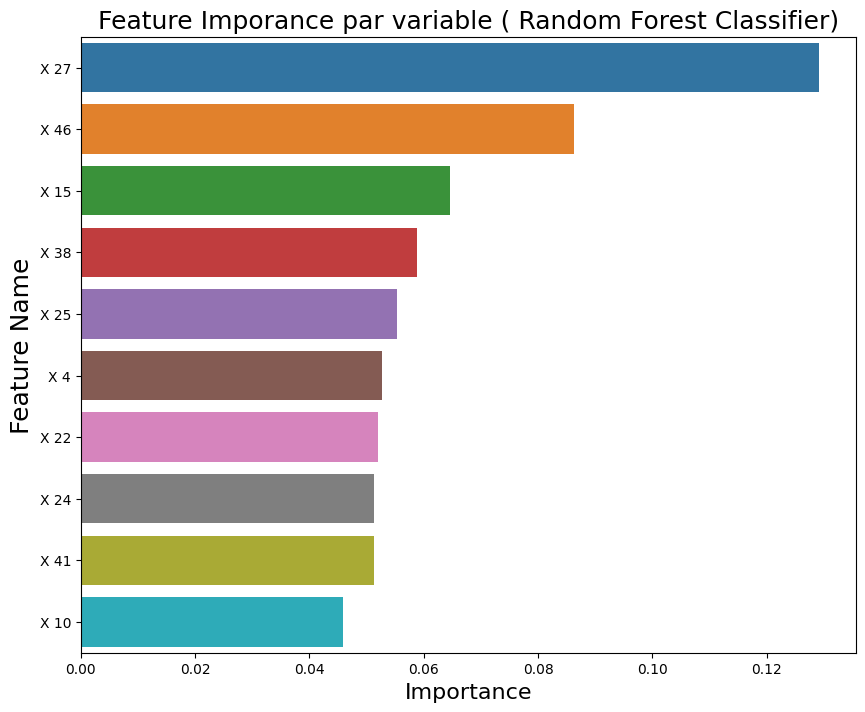

In [37]:
imp_df_=imp_df.head(10)
plt.figure(figsize=(10,8))
sns.barplot(data=imp_df_,x="Importance",y="Feature Name")
plt.title("Feature Imporance par variable ( Random Forest Classifier)",fontsize=18)
plt.xlabel('Importance',fontsize=16)
plt.ylabel("Feature Name",fontsize=18)
plt.show()

On va passer à l'hyperparameter tuning avec seuleument ces 10 variables :
+ X 27
+ X 46
+ X 15
+ X 38
+ X 25
+ X 4
+ X 22
+ X 24
+ X 41
+ X 10


In [38]:
features=imp_df_['Feature Name'].tolist()

In [39]:
features.append('class')

In [40]:
data_tuning=dataset.loc[:,features]


In [41]:
modelisation_tuning=modeling(data_tuning,'class')

In [42]:
modelisation_tuning.X,modelisation_tuning.y=sm.fit_resample(modelisation_tuning.X,modelisation_tuning.y)


In [43]:
X_train_smote_tuning, X_test_smote_tuning, y_train_smote_tuning, y_test_smote_tuning =modelisation_tuning.train_test_split(0.3)


In [44]:
X_train_scaled_smote_tuning,X_test_scaled_smote_tuning=modelisation.standardize(X_train_smote_tuning, X_test_smote_tuning)

## Model Tuning

In [40]:
param_grid = {
                
                'criterion': ['gini', 'entropy'],
                'max_depth': [ 3,5,10],
                
            }

In [41]:
if param_grid:
    grid_search = GridSearchCV(best_model_smote, param_grid, cv=5)
    grid_search.fit(X_train_scaled_smote_tuning, y_train_smote_tuning)
    
    best_model_tuned = grid_search.best_estimator_
    print(f"Tuned champion model: {best_model_tuned.__class__.__name__}")
else:
    print("Hyperparameter tuning not supported for the champion model.")

Tuned champion model: RandomForestClassifier


In [43]:
best_model_tuned.get_params

<bound method BaseEstimator.get_params of RandomForestClassifier(max_depth=10, random_state=3)>

In [45]:
champion_model = [(RandomForestClassifier( max_depth=10,random_state=3), X_train_scaled_smote_tuning, y_train_smote_tuning, './Artifacts/random_forest_best_model_tuned.pkl')]
         

In [46]:
for clr, frs, label, out_dir in champion_model:    
     modelisation.dump_best_model(clr, frs, label, out_dir)

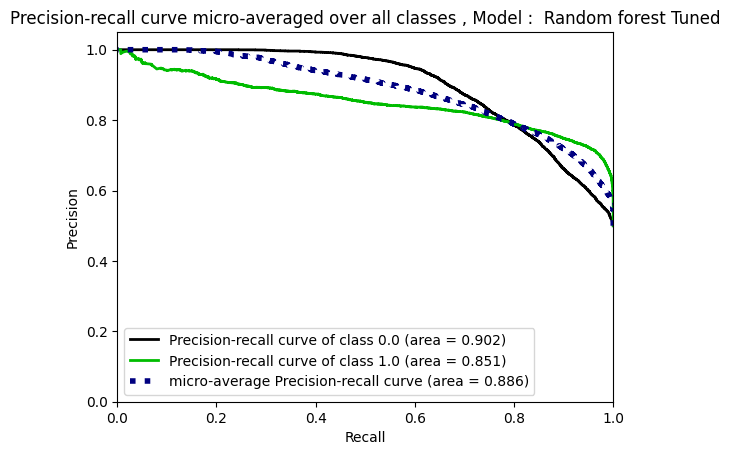

In [48]:
champion_model_tuned = {'./Artifacts/random_forest_best_model_tuned.pkl': 'Random forest Tuned'}
        

for in_dir, title in champion_model_tuned.items():    
     modelisation.plot_curves(in_dir,  X_test_scaled_smote_tuning, y_test_smote_tuning, title)

**Après hyperparameter Tuning**:
+ Même si on remarque une petite diminution au niveau du performance globale du modèle par rapport les résultats avant le tuning du modèle, mais il parait très logique de trouver ce genre de résultats dans des problèmes de classification multiclass avec plus de + classes et une data très "imbalanced".
+ Reste à dire c'est qu'on peut toujours améliorer la performance du modèle champion.